# Feature Extraction

Este notebook busca implementar a segunda etapa do projeto, focando em:
- Detecção de keypoints usando SIFT, ORB e AKAZE
- Comparação entre diferentes detectores
- Visualização das características extraídas
- Otimização de parâmetros para reconstrução 3D

## Setup do Notebook

In [94]:
import sys
import os
sys.path.append('../../src')

from canon.utils import image_utils, notebook_utils
from canon.T2.process import feature_extraction, epipolar_geometry
from canon.T2.plotting import visualization

import cv2
import numpy as np
import matplotlib.pyplot as plt

print("Módulos importados com sucesso")

Módulos importados com sucesso


## Carregamento das Imagens

Usa um dos objetos capturados para análise:

In [95]:
# Objetos disponíveis
objects = [
    "barco_miniatura",
    "estatua", 
    "galinha_honduras",
    "menino_porteira",
    "msc_grandiosa_miniatura"
]

# Escolha do objeto para análise
SELECTED_OBJECT = "msc_grandiosa_miniatura"  # Mudar para extrair características de outro objeto

print(f"Analisando objeto: {SELECTED_OBJECT}")

# Carrega as imagens
images = image_utils.load_images(f"T2/interim/{SELECTED_OBJECT}")
print(f"Carregadas {len(images)} imagens")

sample_names = list(images.keys())[:5]
for name in sample_names:
    img = images[name]
    print(f"  {name}: {img.shape} ({img.shape[0]*img.shape[1]} pixels)")

Analisando objeto: msc_grandiosa_miniatura
Carregadas 100 imagens
  1: (1280, 720, 3) (921600 pixels)
  10: (1280, 720, 3) (921600 pixels)
  100: (1280, 720, 3) (921600 pixels)
  11: (1280, 720, 3) (921600 pixels)
  12: (1280, 720, 3) (921600 pixels)


## Visualização de Imagens de Amostra

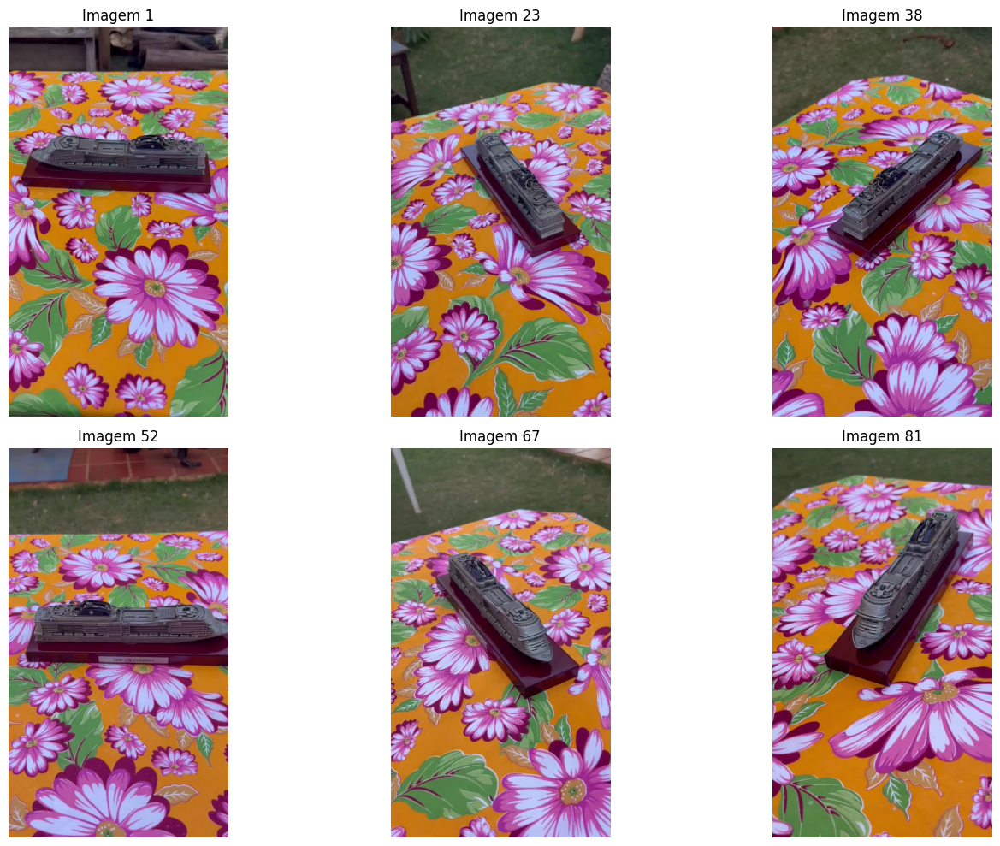

In [96]:
# Mostra algumas imagens de amostra
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes = axes.flatten()

sample_images = list(images.keys())[::len(images)//6][:6]

for i, img_name in enumerate(sample_images):
    img = images[img_name]
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    axes[i].imshow(img_rgb)
    axes[i].set_title(f"Imagem {img_name}")
    axes[i].axis('off')

plt.tight_layout()
plt.show()

## Comparação de Detectores de Características

Vamos comparar SIFT, ORB e AKAZE em uma amostra de imagens:

In [97]:
# Compara detectores em uma amostra de imagens
sample_for_comparison = list(images.keys())[::20][:5]  # Pega 5 imagens espaçadas
print(f"Comparando detectores nas imagens: {sample_for_comparison}")

comparison_results = feature_extraction.compare_detectors(
    images, 
    detectors=["SIFT", "ORB", "AKAZE"],
    sample_images=sample_for_comparison
)

Comparando detectores nas imagens: ['1', '27', '45', '63', '81']

=== Testing SIFT ===
Extracting SIFT features from 5 images...
  1: 5148 keypoints
  27: 5255 keypoints
  45: 5261 keypoints
  63: 5898 keypoints
  81: 4577 keypoints

=== Testing ORB ===
Extracting ORB features from 5 images...
  1: 500 keypoints
  27: 500 keypoints
  45: 500 keypoints
  63: 500 keypoints
  81: 500 keypoints

=== Testing AKAZE ===
Extracting AKAZE features from 5 images...
  1: 2652 keypoints
  27: 2522 keypoints
  45: 2316 keypoints
  63: 2377 keypoints
  81: 2200 keypoints

=== Feature Detection Comparison ===
Image           SIFT     ORB      AKAZE   
---------------------------------------------
1              5148    500     2652    
27             5255    500     2522    
45             5261    500     2316    
63             5898    500     2377    
81             4577    500     2200    


## Visualização da Comparação de Detectores

In [ ]:
# Cria visualização comparativa para uma imagem
test_image = sample_for_comparison[0]
print(f"Criando visualização comparativa para imagem: {test_image}")

# Usa caminho absoluto para evitar problemas
save_path = os.path.abspath(f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-keypoints-visualization")
print(f"Salvando em: {save_path}")

visualization.draw_feature_comparison(
    images, 
    comparison_results, 
    test_image,
    save_path=save_path
)

Criando visualização comparativa para imagem: 1
Salvando em: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/msc_grandiosa_miniatura/Keypoints
✅ Comparação de features salva: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/msc_grandiosa_miniatura/Keypoints/feature_comparison_1.png
✅ SIFT keypoints salvos: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/msc_grandiosa_miniatura/Keypoints/SIFT_1_keypoints.jpg
✅ ORB keypoints salvos: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/msc_grandiosa_miniatura/Keypoints/ORB_1_keypoints.jpg
✅ AKAZE keypoints salvos: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/msc_grandiosa_miniatura/Keypoints/AKAZE_1_keypoints.jpg


## Extração de Características com SIFT

SIFT geralmente é o mais robusto para reconstrução 3D:

In [99]:
# Extrai características SIFT otimizadas para 3D
print("Extraindo características SIFT...")

sift_features = feature_extraction.extract_sift_for_3d(
    images,
    nfeatures=2000,  # Mais características para 3D
    contrastThreshold=0.03,  # Usando threshold mais baixo
    save_visualizations=True,
    output_path=f"T2/interim/{SELECTED_OBJECT}/Keypoints"
)

print(f"\nExtração concluída para {len(sift_features)} imagens")

Extraindo características SIFT...
Extracting SIFT features from 100 images...
  1: 2000 keypoints
  10: 2000 keypoints
  100: 2000 keypoints
  11: 2000 keypoints
  12: 2001 keypoints
  13: 2000 keypoints
  14: 2000 keypoints
  15: 2001 keypoints
  16: 2000 keypoints
  17: 2000 keypoints
  18: 2001 keypoints
  19: 2000 keypoints
  2: 2000 keypoints
  20: 2000 keypoints
  21: 2000 keypoints
  22: 2000 keypoints
  23: 2000 keypoints
  24: 2001 keypoints
  25: 2000 keypoints
  26: 2000 keypoints
  27: 2000 keypoints
  28: 2000 keypoints
  29: 2000 keypoints
  3: 2000 keypoints
  30: 2000 keypoints
  31: 2000 keypoints
  32: 2000 keypoints
  33: 2000 keypoints
  34: 2000 keypoints
  35: 2001 keypoints
  36: 2000 keypoints
  37: 2001 keypoints
  38: 2000 keypoints
  39: 2000 keypoints
  4: 2000 keypoints
  40: 2000 keypoints
  41: 2001 keypoints
  42: 2000 keypoints
  43: 2000 keypoints
  44: 2000 keypoints
  45: 2000 keypoints
  46: 2001 keypoints
  47: 2000 keypoints
  48: 2000 keypoints
 

## Análise das Características Extraídas

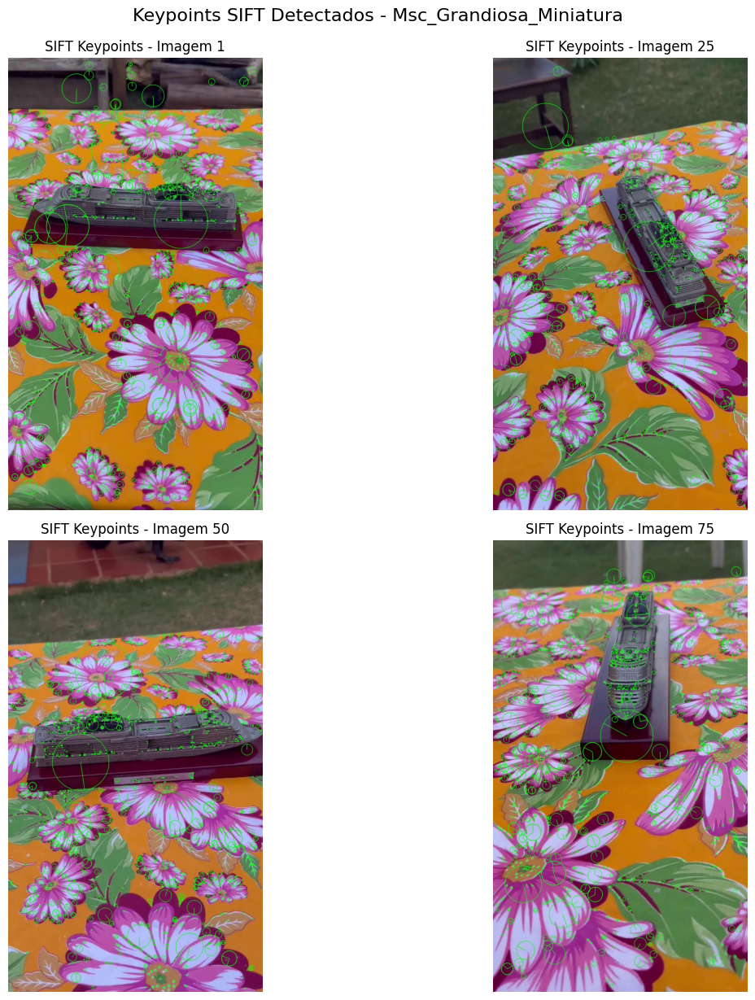

Total de imagens com keypoints geradas: 100
Localização: /home/haylapbv/T2/MC949-Visao-Computacional/data/T2/interim/msc_grandiosa_miniatura/Keypoints


In [100]:
# Visualizar algumas imagens com keypoints SIFT detectados

# Mostrar algumas imagens com keypoints
keypoint_images = [f"SIFT_{i}_keypoints.jpg" for i in [1, 25, 50, 75]]
keypoints_dir = f"../../data/T2/interim/{SELECTED_OBJECT}/Keypoints"

fig, axes = plt.subplots(2, 2, figsize=(15, 12))
axes = axes.flatten()

for i, img_file in enumerate(keypoint_images):
    img_path = os.path.join(keypoints_dir, img_file)
    if os.path.exists(img_path):
        img_with_kp = cv2.imread(img_path)
        img_rgb = cv2.cvtColor(img_with_kp, cv2.COLOR_BGR2RGB)
        
        axes[i].imshow(img_rgb)
        axes[i].set_title(f"SIFT Keypoints - Imagem {img_file.split('_')[1]}")
        axes[i].axis('off')
    else:
        axes[i].text(0.5, 0.5, f"Imagem não encontrada:\n{img_file}", 
                    ha='center', va='center', transform=axes[i].transAxes)
        axes[i].axis('off')

plt.tight_layout()
plt.suptitle(f"Keypoints SIFT Detectados - {SELECTED_OBJECT.title()}", y=1.02, fontsize=16)
plt.show()

print(f"Total de imagens com keypoints geradas: 100")
print(f"Localização: {os.path.abspath(keypoints_dir)}")

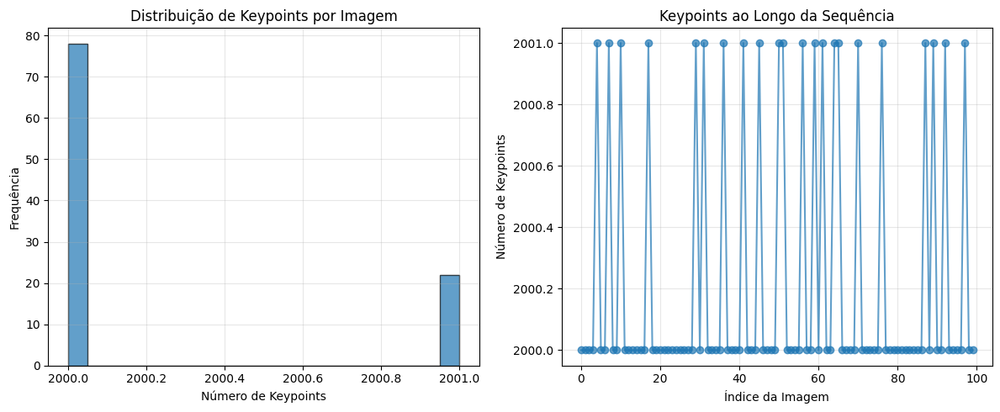


Estatísticas dos Keypoints SIFT:
Média: 2000.2
Mediana: 2000.0
Desvio padrão: 0.4
Mínimo: 2000
Máximo: 2001


In [101]:
# Analisa distribuição de keypoints
keypoint_counts = []
image_names = []

for img_name, features in sift_features.items():
    keypoint_counts.append(features['num_keypoints'])
    image_names.append(img_name)

# Plot da distribuição
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.hist(keypoint_counts, bins=20, alpha=0.7, edgecolor='black')
plt.xlabel('Número de Keypoints')
plt.ylabel('Frequência')
plt.title('Distribuição de Keypoints por Imagem')
plt.grid(True, alpha=0.3)

plt.subplot(1, 2, 2)
plt.plot(keypoint_counts, 'o-', alpha=0.7)
plt.xlabel('Índice da Imagem')
plt.ylabel('Número de Keypoints')
plt.title('Keypoints ao Longo da Sequência')
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Estatísticas
print(f"\nEstatísticas dos Keypoints SIFT:")
print(f"Média: {np.mean(keypoint_counts):.1f}")
print(f"Mediana: {np.median(keypoint_counts):.1f}")
print(f"Desvio padrão: {np.std(keypoint_counts):.1f}")
print(f"Mínimo: {min(keypoint_counts)}")
print(f"Máximo: {max(keypoint_counts)}")

## Teste com ORB (Alternativa Rápida)

In [102]:
# Testa ORB em uma amostra menor
sample_images_dict = {k: v for k, v in list(images.items())[:10]}

print("Extraindo características ORB...")
orb_features = feature_extraction.extract_orb_for_3d(
    sample_images_dict,
    nfeatures=3000,
    save_visualizations=True,  # Habilitando salvamento das visualizações ORB
    output_path=f"T2/interim/{SELECTED_OBJECT}/Keypoints"
)

# Compara contagens
orb_counts = [features['num_keypoints'] for features in orb_features.values()]

# Verificar se sift_features existe, se não, extrair SIFT para comparação
if 'sift_features' not in locals():
    print("Extraindo características SIFT para comparação...")
    sift_sample_features = feature_extraction.extract_sift_for_3d(
        sample_images_dict,
        nfeatures=2000,
        save_visualizations=False  # Evita salvar as visualizações novamente
    )
    sift_sample_counts = [features['num_keypoints'] for features in sift_sample_features.values()]
else:
    sift_sample_counts = [sift_features[name]['num_keypoints'] for name in sample_images_dict.keys()]

print(f"\nComparação SIFT vs ORB (amostra de {len(sample_images_dict)} imagens):")
print(f"SIFT - Média: {np.mean(sift_sample_counts):.1f}")
print(f"ORB  - Média: {np.mean(orb_counts):.1f}")

# Mostra informações sobre as visualizações ORB salvas
print(f"\nVisualizações ORB salvas:")
saved_count = 0
for img_name, features in orb_features.items():
    if 'visualization_saved' in features:
        saved_count += 1
        print(f"  {img_name}: {features['visualization_saved']}")

print(f"Total de imagens ORB com keypoints salvas: {saved_count}")

# Lista arquivos ORB salvos no diretório
orb_dir = f"../../data/T2/interim/{SELECTED_OBJECT}"
if os.path.exists(orb_dir):
    orb_files = [f for f in os.listdir(orb_dir) if f.startswith('ORB_') and f.endswith('_keypoints.jpg')]
    print(f"\nArquivos ORB encontrados no diretório ({len(orb_files)} total):")
    for orb_file in sorted(orb_files)[:5]:  # Mostrar apenas os primeiros 5
        print(f"  {orb_file}")
    if len(orb_files) > 5:
        print(f"  ... e mais {len(orb_files) - 5} arquivos")

Extraindo características ORB...
Extracting ORB features from 10 images...
  1: 3000 keypoints
  10: 3000 keypoints
  100: 3000 keypoints
  11: 3000 keypoints
  12: 3000 keypoints
  13: 3000 keypoints
  14: 3000 keypoints
  15: 3000 keypoints
  16: 3000 keypoints
  17: 3000 keypoints

Comparação SIFT vs ORB (amostra de 10 imagens):
SIFT - Média: 2000.2
ORB  - Média: 3000.0

Visualizações ORB salvas:
  1: T2/interim/msc_grandiosa_miniatura/Keypoints/ORB_1_keypoints.jpg
  10: T2/interim/msc_grandiosa_miniatura/Keypoints/ORB_10_keypoints.jpg
  100: T2/interim/msc_grandiosa_miniatura/Keypoints/ORB_100_keypoints.jpg
  11: T2/interim/msc_grandiosa_miniatura/Keypoints/ORB_11_keypoints.jpg
  12: T2/interim/msc_grandiosa_miniatura/Keypoints/ORB_12_keypoints.jpg
  13: T2/interim/msc_grandiosa_miniatura/Keypoints/ORB_13_keypoints.jpg
  14: T2/interim/msc_grandiosa_miniatura/Keypoints/ORB_14_keypoints.jpg
  15: T2/interim/msc_grandiosa_miniatura/Keypoints/ORB_15_keypoints.jpg
  16: T2/interim/msc_

## Salvamento dos Resultados

In [103]:
# Salva features para uso na próxima etapa
import pickle

# Prepara dados para salvamento (remover objetos OpenCV que não são serializáveis)
features_to_save = {}
for img_name, features in sift_features.items():
    # Converte keypoints para formato serializável
    kp_data = [(kp.pt, kp.angle, kp.size, kp.response) for kp in features['keypoints']]
    
    features_to_save[img_name] = {
        'keypoints_data': kp_data,
        'descriptors': features['descriptors'],
        'num_keypoints': features['num_keypoints'],
        'image_shape': features['image_shape'],
        'detector_type': features['detector_type']
    }

# Salva
save_path = f"../../data/T2/interim/{SELECTED_OBJECT}/sift_features.pkl"
with open(save_path, 'wb') as f:
    pickle.dump(features_to_save, f)

print(f"Características SIFT salvas em: {save_path}")
print(f"Dados salvos para {len(features_to_save)} imagens")

Características SIFT salvas em: ../../data/T2/interim/msc_grandiosa_miniatura/sift_features.pkl
Dados salvos para 100 imagens


## Comparação Completa: SIFT vs ORB vs AKAZE

In [104]:
# Comparação completa dos três detectores
print("Realizando comparação SIFT vs ORB vs AKAZE...")

# Seleciona uma amostra menor para análise detalhada (5 imagens)
sample_keys = list(images.keys())[::20][:5]
sample_images = {k: images[k] for k in sample_keys}

print(f"Analisando imagens: {list(sample_images.keys())}")

# Extrai características com os três detectores
all_detectors = {}

# SIFT
print("\n Extraindo SIFT...")
sift_results = feature_extraction.extract_sift_for_3d(
    sample_images, 
    nfeatures=2000,
    save_visualizations=False
)
all_detectors['SIFT'] = sift_results

# ORB  
print("Extraindo ORB...")
orb_results = feature_extraction.extract_orb_for_3d(
    sample_images,
    nfeatures=3000,
    save_visualizations=True,  # Habilitando salvamento das visualizações ORB
    output_path=f"T2/interim/{SELECTED_OBJECT}/Keypoints"
)
all_detectors['ORB'] = orb_results

# AKAZE
print("Extraindo AKAZE...")
akaze_results = feature_extraction.extract_akaze_for_3d(
    sample_images,
    save_visualizations=False
)
all_detectors['AKAZE'] = akaze_results

print("Extração concluída para todos os detectores!")

# Análise estatística
print("\n" + "="*50)
print("ANÁLISE COMPARATIVA DE DETECTORES")
print("="*50)

for detector_name, features_dict in all_detectors.items():
    counts = [features['num_keypoints'] for features in features_dict.values()]
    
    print(f"\n{detector_name}:")
    print(f"  Média de keypoints: {np.mean(counts):.1f}")
    print(f"  Mediana: {np.median(counts):.1f}")
    print(f"  Desvio padrão: {np.std(counts):.1f}")
    print(f"  Min-Max: {min(counts)} - {max(counts)}")

# Informações específicas sobre visualizações ORB salvas
print(f"\nVisualizações ORB salvas na comparação:")
orb_saved_count = 0
for img_name, features in orb_results.items():
    if 'visualization_saved' in features:
        orb_saved_count += 1
        print(f"  {img_name}: {features['visualization_saved']}")

print(f"Total de imagens ORB com keypoints salvas: {orb_saved_count}")
print("\n" + "="*50)

Realizando comparação SIFT vs ORB vs AKAZE...
Analisando imagens: ['1', '27', '45', '63', '81']

 Extraindo SIFT...
Extracting SIFT features from 5 images...
  1: 2000 keypoints
  27: 2000 keypoints
  45: 2000 keypoints
  63: 2000 keypoints
  81: 2000 keypoints
Extraindo ORB...
Extracting ORB features from 5 images...
  1: 3000 keypoints
  27: 3000 keypoints
  45: 3000 keypoints
  63: 3000 keypoints
  81: 3000 keypoints
Extraindo AKAZE...
Extracting AKAZE features from 5 images...
  1: 4229 keypoints
  27: 3995 keypoints
  45: 3751 keypoints
  63: 3873 keypoints
  81: 3750 keypoints
Extração concluída para todos os detectores!

ANÁLISE COMPARATIVA DE DETECTORES

SIFT:
  Média de keypoints: 2000.0
  Mediana: 2000.0
  Desvio padrão: 0.0
  Min-Max: 2000 - 2000

ORB:
  Média de keypoints: 3000.0
  Mediana: 3000.0
  Desvio padrão: 0.0
  Min-Max: 3000 - 3000

AKAZE:
  Média de keypoints: 3919.6
  Mediana: 3873.0
  Desvio padrão: 179.3
  Min-Max: 3750 - 4229

Visualizações ORB salvas na compa

Criando comparação visual para: 45


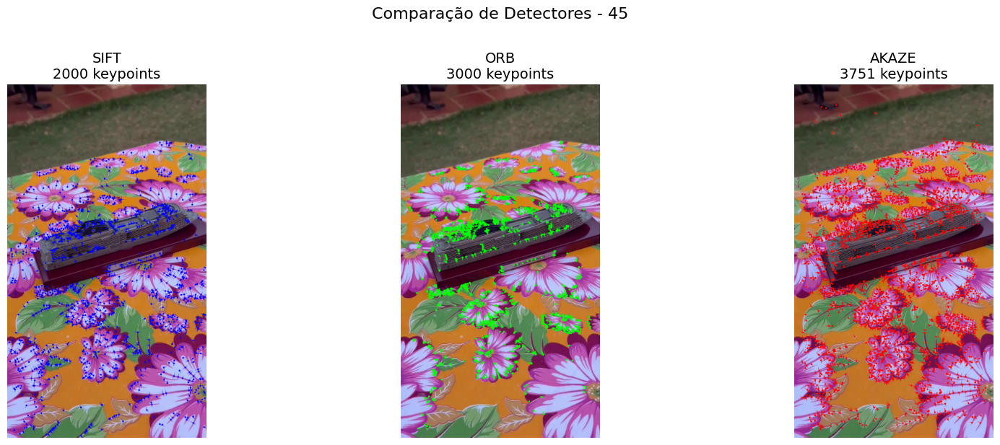

Comparação salva em: ../../data/T2/interim/msc_grandiosa_miniatura/ComparingMatchers/detector_comparison_45.jpg

 Resultados para 45:
  SIFT: 2000 keypoints
  ORB: 3000 keypoints
  AKAZE: 3751 keypoints


In [ ]:
# Visualização comparativa lado a lado

def draw_keypoints_on_image(image, keypoints, color=(0, 255, 0)):
    img_with_kp = image.copy()
    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])
        cv2.circle(img_with_kp, (x, y), 3, color, -1)
        # Desenha orientação se disponível
        if hasattr(kp, 'angle') and kp.angle != -1:
            end_x = int(x + 10 * np.cos(np.radians(kp.angle)))
            end_y = int(y + 10 * np.sin(np.radians(kp.angle)))
            cv2.line(img_with_kp, (x, y), (end_x, end_y), color, 1)
    return img_with_kp

# Escolhe uma imagem para comparação visual
test_image_name = list(sample_images.keys())[2]  # Terceira imagem
test_image = sample_images[test_image_name]

print(f"Criando comparação visual para: {test_image_name}")

# Cria subplot com os três detectores
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Cores diferentes para cada detector
colors = {
    'SIFT': (255, 0, 0),    # Vermelho
    'ORB': (0, 255, 0),     # Verde  
    'AKAZE': (0, 0, 255)    # Azul
}

detector_names = ['SIFT', 'ORB', 'AKAZE']

for i, detector_name in enumerate(detector_names):
    # Pega os keypoints desta imagem para este detector
    features = all_detectors[detector_name][test_image_name]
    keypoints = features['keypoints']
    
    # Desenha keypoints
    img_with_kp = draw_keypoints_on_image(test_image, keypoints, colors[detector_name])
    img_rgb = cv2.cvtColor(img_with_kp, cv2.COLOR_BGR2RGB)
    
    # Mostra no subplot
    axes[i].imshow(img_rgb)
    axes[i].set_title(f'{detector_name}\n{len(keypoints)} keypoints', fontsize=14)
    axes[i].axis('off')

plt.suptitle(f'Comparação de Detectores - {test_image_name}', fontsize=16, y=1.02)
plt.tight_layout()
plt.show()

# Salva a comparação
save_dir = f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-detector-comparison"
os.makedirs(save_dir, exist_ok=True)
save_path = os.path.join(save_dir, f"detector_comparison_{test_image_name}.jpg")
fig.savefig(save_path, dpi=150, bbox_inches='tight')
print(f"Comparação salva em: {save_path}")

print(f"\n Resultados para {test_image_name}:")
for detector_name in detector_names:
    count = len(all_detectors[detector_name][test_image_name]['keypoints'])
    print(f"  {detector_name}: {count} keypoints")

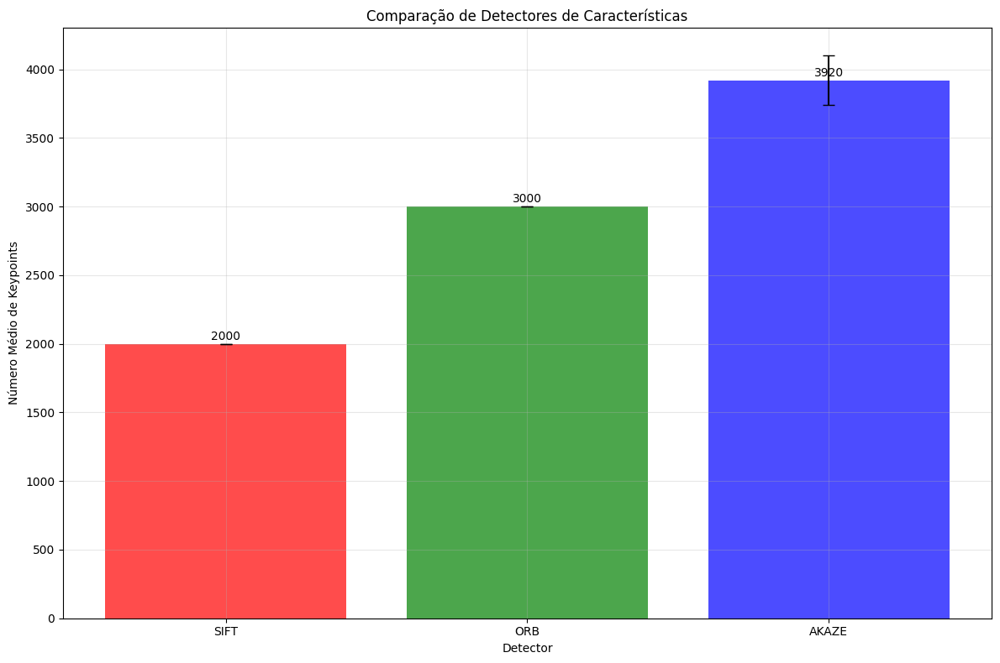

Análise comparativa completa finalizada!


In [106]:
# Salva visualizações individuais de cada detector
save_individual = False  # Mudar para True para salvar todas

if save_individual:
    print("Salvando visualizações individuais...")
    
    for detector_name in detector_names:
        detector_features = all_detectors[detector_name]
        
        # Cria subdiretório para este detector
        detector_dir = os.path.join(save_dir, f"{detector_name.lower()}_keypoints")
        os.makedirs(detector_dir, exist_ok=True)
        
        saved_count = 0
        for img_name, features in detector_features.items():
            img = sample_images[img_name]
            keypoints = features['keypoints']
            
            # Desenha keypoints
            img_with_kp = draw_keypoints_on_image(img, keypoints, colors[detector_name])
            
            # Salva
            output_path = os.path.join(detector_dir, f"{detector_name}_{img_name}_keypoints.jpg")
            cv2.imwrite(output_path, img_with_kp)
            saved_count += 1
        
        print(f"  {detector_name}: {saved_count} imagens salvas em {detector_dir}")

# Gráfico comparativo final
plt.figure(figsize=(12, 8))

# Dados para o gráfico
detector_means = []
detector_stds = []

for detector_name in detector_names:
    counts = [features['num_keypoints'] for features in all_detectors[detector_name].values()]
    detector_means.append(np.mean(counts))
    detector_stds.append(np.std(counts))

# Gráfico de barras
x_pos = np.arange(len(detector_names))
bars = plt.bar(x_pos, detector_means, yerr=detector_stds, 
               capsize=5, alpha=0.7, 
               color=['red', 'green', 'blue'])

plt.xlabel('Detector')
plt.ylabel('Número Médio de Keypoints')
plt.title('Comparação de Detectores de Características')
plt.xticks(x_pos, detector_names)
plt.grid(True, alpha=0.3)

# Adiciona valores nas barras
for bar, mean in zip(bars, detector_means):
    plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 10,
             f'{mean:.0f}', ha='center', va='bottom')

plt.tight_layout()
plt.show()

print("Análise comparativa completa finalizada!")

## Comparação Detalhada de Matches: Detectores vs Matchers

In [107]:
# Seleciona duas imagens específicas para comparação detalhada
img1_name = list(images.keys())[10]  # Primeira imagem
img2_name = list(images.keys())[12]  # Imagem 12 (mais próxima)

img1 = images[img1_name]
img2 = images[img2_name]

print(f"Analisando matches entre:")
print(f"  Imagem 1: {img1_name} - {img1.shape}")  
print(f"  Imagem 2: {img2_name} - {img2.shape}")

# Extrai características de ambas as imagens com os três detectores
detectors_for_matching = {}

print(f"\nExtraindo características para análise de matches...")

# SIFT
print("Extraindo SIFT...")
sift_img1 = feature_extraction.extract_features_from_image_set(
    {img1_name: img1}, "SIFT", nfeatures=2000
)
sift_img2 = feature_extraction.extract_features_from_image_set(
    {img2_name: img2}, "SIFT", nfeatures=2000
)
detectors_for_matching['SIFT'] = {
    'img1': sift_img1[img1_name],
    'img2': sift_img2[img2_name]
}

# ORB  
print("Extraindo ORB...")
orb_img1 = feature_extraction.extract_features_from_image_set(
    {img1_name: img1}, "ORB", nfeatures=3000
)
orb_img2 = feature_extraction.extract_features_from_image_set(
    {img2_name: img2}, "ORB", nfeatures=3000
)
detectors_for_matching['ORB'] = {
    'img1': orb_img1[img1_name],
    'img2': orb_img2[img2_name]
}

# AKAZE
print("Extraindo AKAZE...")
akaze_img1 = feature_extraction.extract_features_from_image_set(
    {img1_name: img1}, "AKAZE"
)
akaze_img2 = feature_extraction.extract_features_from_image_set(
    {img2_name: img2}, "AKAZE"
)
detectors_for_matching['AKAZE'] = {
    'img1': akaze_img1[img1_name],
    'img2': akaze_img2[img2_name]
}

print(f"\nCaracterísticas extraídas:")
for detector, data in detectors_for_matching.items():
    kp1_count = len(data['img1'][0]) if data['img1'][0] else 0
    kp2_count = len(data['img2'][0]) if data['img2'][0] else 0
    print(f"  {detector}: {kp1_count} + {kp2_count} keypoints")

Analisando matches entre:
  Imagem 1: 18 - (1280, 720, 3)
  Imagem 2: 2 - (1280, 720, 3)

Extraindo características para análise de matches...
Extraindo SIFT...
Extracting SIFT features from 1 images...


  18: 2000 keypoints
Extracting SIFT features from 1 images...
  2: 2000 keypoints
Extraindo ORB...
Extracting ORB features from 1 images...
  18: 3000 keypoints
Extracting ORB features from 1 images...
  2: 3000 keypoints
Extraindo AKAZE...
Extracting AKAZE features from 1 images...
  18: 2844 keypoints
Extracting AKAZE features from 1 images...
  2: 2699 keypoints

Características extraídas:
  SIFT: 2000 + 2000 keypoints
  ORB: 3000 + 3000 keypoints
  AKAZE: 2844 + 2699 keypoints


In [108]:
# Análise completa de matches: Detectores vs Matchers

# Configura matchers
bf_matcher = epipolar_geometry.ImagePairMatcher(
    matcher_type="BF", 
    ratio_threshold=0.75,
    cross_check=False
)

flann_matcher = epipolar_geometry.ImagePairMatcher(
    matcher_type="FLANN",
    ratio_threshold=0.75
)

print("Matchers configurados:")
print("- Brute Force (BF) com Lowe's ratio test (0.75)")
print("- FLANN-based matcher com Lowe's ratio test (0.75)")

def create_enhanced_match_visualization(img1, img2, kp1, kp2, matches, title, max_matches=50):

    # Limita número de matches para visualização mais limpa
    display_matches = matches[:max_matches] if len(matches) > max_matches else matches
    
    # Cria visualização com keypoints e matches
    img_matches = cv2.drawMatches(
        img1, kp1, img2, kp2, display_matches,
        None,
        flags=cv2.DrawMatchesFlags_DEFAULT,  # Mostra todos os keypoints
        matchColor=(0, 255, 0),      # Verde para matches
        singlePointColor=(255, 0, 0), # Vermelho para keypoints sem correspondentes
        matchesMask=None
    )
    
    return img_matches

def perform_matching_analysis_enhanced(detector_name, features1, features2, img1, img2):

    kp1, desc1 = features1
    kp2, desc2 = features2
    
    if desc1 is None or desc2 is None:
        return {'BF': None, 'FLANN': None}
    
    results = {}
    
    # Testar ambos os matchers
    for matcher_name, matcher in [("BF", bf_matcher), ("FLANN", flann_matcher)]:
        try:
            matches = matcher.match_features(desc1, desc2, apply_ratio_test=True)
            
            if len(matches) > 10:  # Só processa se tiver matches suficientes
                img_matches = create_enhanced_match_visualization(
                    img1, img2, kp1, kp2, matches, 
                    f"{detector_name}-{matcher_name}"
                )
                
                results[matcher_name] = {
                    'matches': matches,
                    'num_matches': len(matches),
                    'img_matches': img_matches,
                    'num_keypoints_img1': len(kp1),
                    'num_keypoints_img2': len(kp2),
                    'success': True
                }
            else:
                results[matcher_name] = {
                    'matches': [],
                    'num_matches': 0,
                    'img_matches': None,
                    'num_keypoints_img1': len(kp1) if kp1 else 0,
                    'num_keypoints_img2': len(kp2) if kp2 else 0,
                    'success': False
                }
                
        except Exception as e:
            print(f"Erro com {detector_name}-{matcher_name}: {e}")
            results[matcher_name] = {
                'matches': [],
                'num_matches': 0,
                'img_matches': None,
                'num_keypoints_img1': len(kp1) if kp1 else 0,
                'num_keypoints_img2': len(kp2) if kp2 else 0,
                'success': False
            }
    
    return results

print("\nAnálise configurada com visualização COMPLETA:")

Matchers configurados:
- Brute Force (BF) com Lowe's ratio test (0.75)
- FLANN-based matcher com Lowe's ratio test (0.75)

Análise configurada com visualização COMPLETA:


In [109]:
# Realiza análise detalhada para todos os detectores
print("Realizando análise COMPLETA de matches (keypoints + correspondências)...")
print("="*70)

# Usa dados já extraídos da análise anterior
matching_results = {}

for detector_name in ['SIFT', 'ORB', 'AKAZE']:
    print(f"\n Analisando {detector_name}...")
    
    data = detectors_for_matching[detector_name]
    features1 = data['img1']  # (keypoints, descriptors)
    features2 = data['img2']  # (keypoints, descriptors)
    
    # Realiza análise de matching ENHANCED
    analysis = perform_matching_analysis_enhanced(
        detector_name, features1, features2, img1, img2
    )
    
    matching_results[detector_name] = analysis
    
    # Mostra os resultados detalhados
    for matcher_name in ['BF', 'FLANN']:
        result = analysis[matcher_name]
        if result and result['success']:
            print(f"{detector_name}-{matcher_name}: {result['num_matches']:3d} matches | "
                  f"KP1: {result['num_keypoints_img1']:3d} | KP2: {result['num_keypoints_img2']:3d}")
        else:
            kp1_count = result['num_keypoints_img1'] if result else 0
            kp2_count = result['num_keypoints_img2'] if result else 0
            print(f"{detector_name}-{matcher_name}: Falha ou poucos matches | "
                  f"KP1: {kp1_count:3d} | KP2: {kp2_count:3d}")

print("\n" + "="*70)
print("Análise de matching COMPLETA concluída!")
print("   • Visualizações incluem keypoints (pontos vermelhos) E matches (linhas verdes)")

# Mostra resumo estatístico expandido
print(f"\nResumo Estatístico Detalhado:")
print(f"{'Detector':<8} {'BF Matches':<11} {'FLANN Matches':<13} {'Keypoints Img1':<14} {'Keypoints Img2':<14}")
print("-" * 75)

for detector in ['SIFT', 'ORB', 'AKAZE']:
    bf_result = matching_results[detector]['BF']
    flann_result = matching_results[detector]['FLANN']
    
    bf_matches = bf_result['num_matches'] if bf_result and bf_result['success'] else 0
    flann_matches = flann_result['num_matches'] if flann_result and flann_result['success'] else 0
    
    # Pega keypoints do primeiro resultado válido
    kp1_count = bf_result['num_keypoints_img1'] if bf_result else 0
    kp2_count = bf_result['num_keypoints_img2'] if bf_result else 0
    
    print(f"{detector:<8} {bf_matches:<11} {flann_matches:<13} {kp1_count:<14} {kp2_count:<14}")

print("-" * 75)

Realizando análise COMPLETA de matches (keypoints + correspondências)...

 Analisando SIFT...
SIFT-BF: 262 matches | KP1: 2000 | KP2: 2000
SIFT-FLANN: 282 matches | KP1: 2000 | KP2: 2000

 Analisando ORB...
ORB-BF: 164 matches | KP1: 3000 | KP2: 3000
ORB-FLANN: 188 matches | KP1: 3000 | KP2: 3000

 Analisando AKAZE...
AKAZE-BF: 208 matches | KP1: 2844 | KP2: 2699
AKAZE-FLANN: 227 matches | KP1: 2844 | KP2: 2699

Análise de matching COMPLETA concluída!
   • Visualizações incluem keypoints (pontos vermelhos) E matches (linhas verdes)

Resumo Estatístico Detalhado:
Detector BF Matches  FLANN Matches Keypoints Img1 Keypoints Img2
---------------------------------------------------------------------------
SIFT     262         282           2000           2000          
ORB      164         188           3000           3000          
AKAZE    208         227           2844           2699          
---------------------------------------------------------------------------


## Visualizações Individuais de Matches: Detector + Matcher

=== SIFT + Brute Force Matcher ===


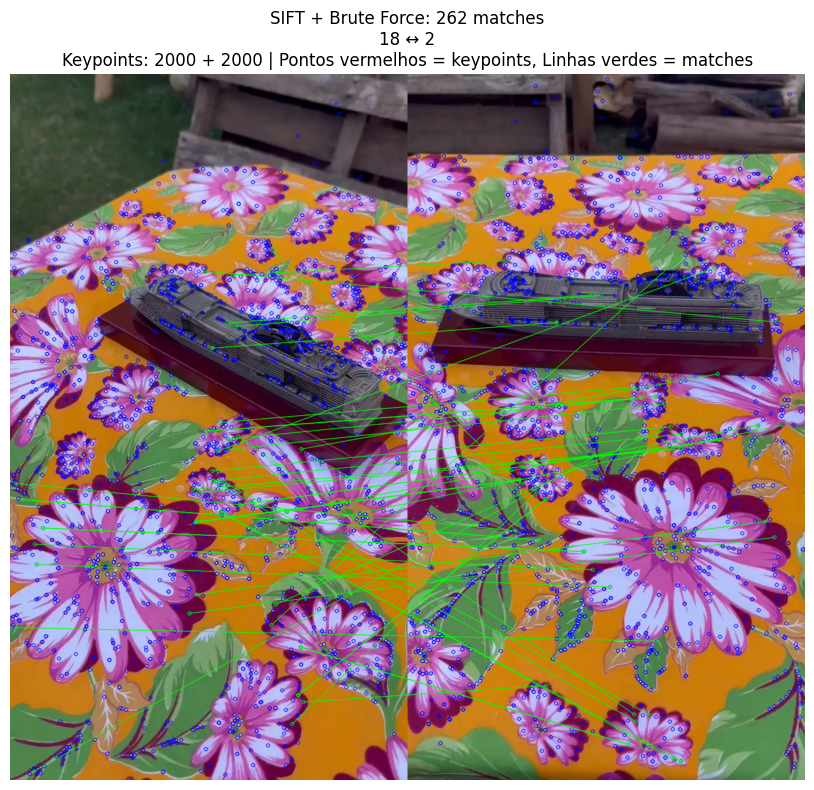

 Salvo: ../../data/T2/interim/msc_grandiosa_miniatura/ComparingMatchers/SIFT-BFMatcher-pair.jpg
 Resultados:
   • Matches encontrados: 262
   • Keypoints Img1: 2000
   • Keypoints Img2: 2000
   • Eficiência: 6.6%



In [ ]:
# 1. SIFT + BF Matcher
print("=== SIFT + Brute Force Matcher ===")

if matching_results['SIFT']['BF'] and matching_results['SIFT']['BF']['success']:
    sift_bf_result = matching_results['SIFT']['BF']
    
    # Mostrar imagem com informações detalhadas
    plt.figure(figsize=(16, 8))
    img_rgb = cv2.cvtColor(sift_bf_result['img_matches'], cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)
    
    # Título com informações completas
    title = (f'SIFT + Brute Force: {sift_bf_result["num_matches"]} matches\n'
             f'{img1_name} ↔ {img2_name}\n'
             f'Keypoints: {sift_bf_result["num_keypoints_img1"]} + {sift_bf_result["num_keypoints_img2"]} '
             f'| Pontos vermelhos = keypoints, Linhas verdes = matches')
    
    plt.title(title, fontsize=12)
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    # Salvar imagem
    save_path = f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-matcher-comparison/SIFT-BFMatcher-pair.jpg"
    cv2.imwrite(save_path, sift_bf_result['img_matches'])
    print(f" Salvo: {save_path}")
    print(f" Resultados:")
    print(f"   • Matches encontrados: {sift_bf_result['num_matches']}")
    print(f"   • Keypoints Img1: {sift_bf_result['num_keypoints_img1']}")
    print(f"   • Keypoints Img2: {sift_bf_result['num_keypoints_img2']}")
    print(f"   • Eficiência: {sift_bf_result['num_matches']/(sift_bf_result['num_keypoints_img1']+sift_bf_result['num_keypoints_img2'])*100:.1f}%")
else:
    print(" SIFT + BF: Falha na análise")

print("\n" + "="*50)

=== SIFT + FLANN Matcher ===


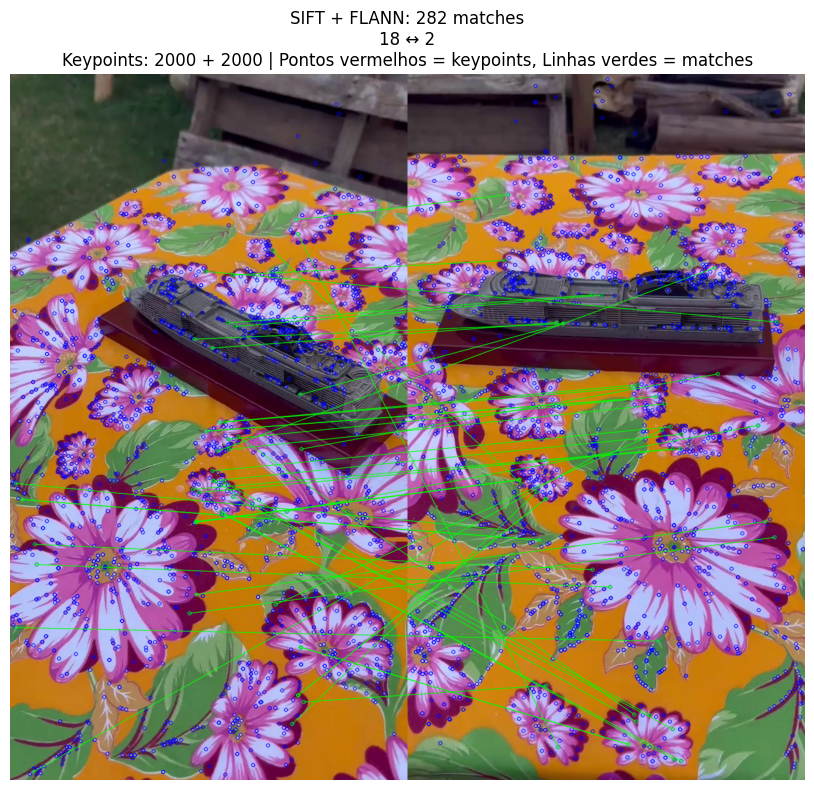

 Salvo: ../../data/T2/interim/msc_grandiosa_miniatura/ComparingMatchers/SIFT-FlannBasedMatcher-pair.jpg
 Resultados:
   • Matches encontrados: 282
   • Keypoints Img1: 2000
   • Keypoints Img2: 2000
   • Eficiência: 7.0%



In [ ]:
# 2. SIFT + FLANN Matcher
print("=== SIFT + FLANN Matcher ===")

if matching_results['SIFT']['FLANN'] and matching_results['SIFT']['FLANN']['success']:
    sift_flann_result = matching_results['SIFT']['FLANN']
    
    # Mostrar imagem com informações detalhadas
    plt.figure(figsize=(16, 8))
    img_rgb = cv2.cvtColor(sift_flann_result['img_matches'], cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)
    
    # Título com informações completas
    title = (f'SIFT + FLANN: {sift_flann_result["num_matches"]} matches\n'
             f'{img1_name} ↔ {img2_name}\n'
             f'Keypoints: {sift_flann_result["num_keypoints_img1"]} + {sift_flann_result["num_keypoints_img2"]} '
             f'| Pontos vermelhos = keypoints, Linhas verdes = matches')
    
    plt.title(title, fontsize=12)
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    # Salvar imagem
    save_path = f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-matcher-comparison/SIFT-FlannBasedMatcher-pair.jpg"
    cv2.imwrite(save_path, sift_flann_result['img_matches'])
    print(f" Salvo: {save_path}")
    print(f" Resultados:")
    print(f"   • Matches encontrados: {sift_flann_result['num_matches']}")
    print(f"   • Keypoints Img1: {sift_flann_result['num_keypoints_img1']}")
    print(f"   • Keypoints Img2: {sift_flann_result['num_keypoints_img2']}")
    print(f"   • Eficiência: {sift_flann_result['num_matches']/(sift_flann_result['num_keypoints_img1']+sift_flann_result['num_keypoints_img2'])*100:.1f}%")
else:
    print(" SIFT + FLANN: Falha na análise")

print("\n" + "="*50)

=== ORB + Brute Force Matcher ===


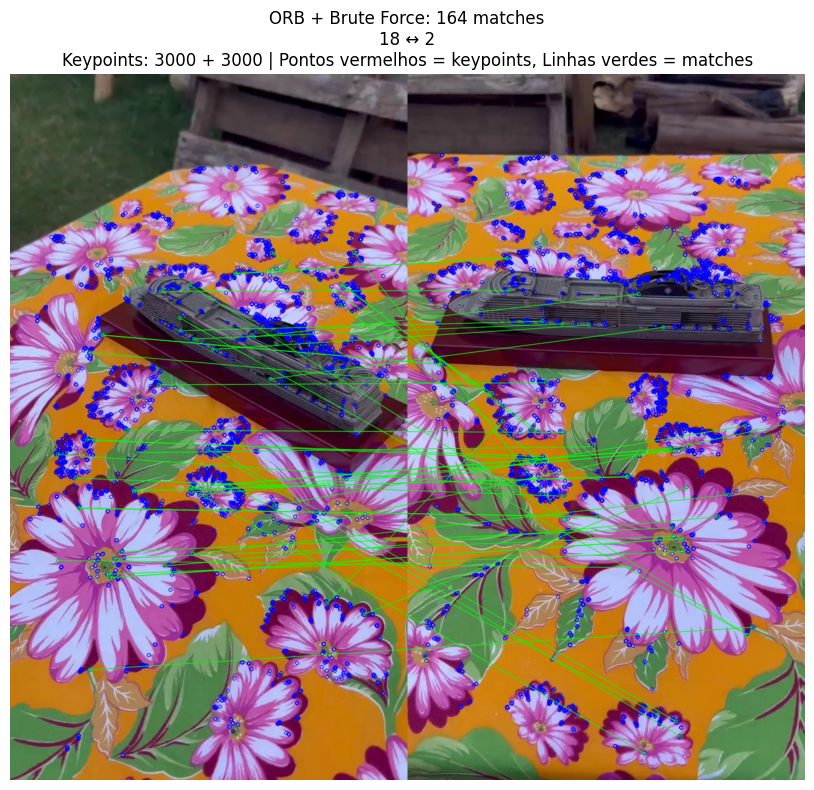

 Salvo: ../../data/T2/interim/msc_grandiosa_miniatura/ComparingMatchers/ORB-BFMatcher-pair.jpg
 Resultados:
   • Matches encontrados: 164
   • Keypoints Img1: 3000
   • Keypoints Img2: 3000
   • Eficiência: 2.7%

=== ORB + FLANN Matcher ===


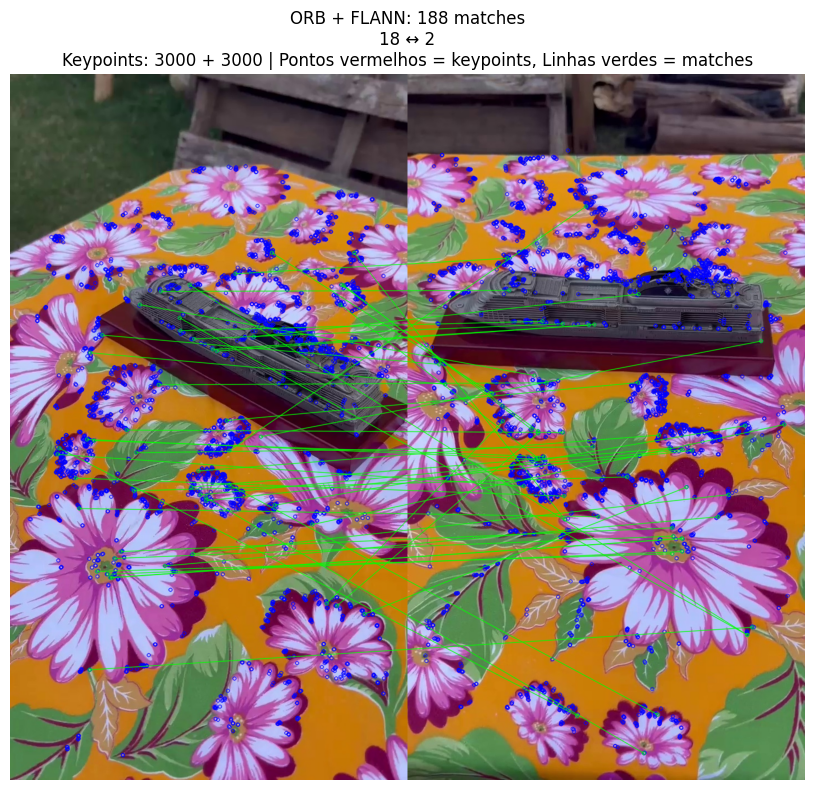

 Salvo: ../../data/T2/interim/msc_grandiosa_miniatura/ComparingMatchers/ORB-FlannBasedMatcher-pair.jpg
 Resultados:
   • Matches encontrados: 188
   • Keypoints Img1: 3000
   • Keypoints Img2: 3000
   • Eficiência: 3.1%



In [ ]:
# 3. ORB + BF Matcher
print("=== ORB + Brute Force Matcher ===")

if matching_results['ORB']['BF'] and matching_results['ORB']['BF']['success']:
    orb_bf_result = matching_results['ORB']['BF']
    
    # Mostrar imagem com informações detalhadas
    plt.figure(figsize=(16, 8))
    img_rgb = cv2.cvtColor(orb_bf_result['img_matches'], cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)
    
    # Título com informações completas
    title = (f'ORB + Brute Force: {orb_bf_result["num_matches"]} matches\n'
             f'{img1_name} ↔ {img2_name}\n'
             f'Keypoints: {orb_bf_result["num_keypoints_img1"]} + {orb_bf_result["num_keypoints_img2"]} '
             f'| Pontos vermelhos = keypoints, Linhas verdes = matches')
    
    plt.title(title, fontsize=12)
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    # Salvar imagem
    save_path = f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-matcher-comparison/ORB-BFMatcher-pair.jpg"
    cv2.imwrite(save_path, orb_bf_result['img_matches'])
    print(f" Salvo: {save_path}")
    print(f" Resultados:")
    print(f"   • Matches encontrados: {orb_bf_result['num_matches']}")
    print(f"   • Keypoints Img1: {orb_bf_result['num_keypoints_img1']}")
    print(f"   • Keypoints Img2: {orb_bf_result['num_keypoints_img2']}")
    print(f"   • Eficiência: {orb_bf_result['num_matches']/(orb_bf_result['num_keypoints_img1']+orb_bf_result['num_keypoints_img2'])*100:.1f}%")
else:
    print(" ORB + BF: Falha na análise")

print("\n" + "="*50)

# 4. ORB + FLANN Matcher
print("=== ORB + FLANN Matcher ===")

if matching_results['ORB']['FLANN'] and matching_results['ORB']['FLANN']['success']:
    orb_flann_result = matching_results['ORB']['FLANN']
    
    # Mostrar imagem com informações detalhadas
    plt.figure(figsize=(16, 8))
    img_rgb = cv2.cvtColor(orb_flann_result['img_matches'], cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)
    
    # Título com informações completas
    title = (f'ORB + FLANN: {orb_flann_result["num_matches"]} matches\n'
             f'{img1_name} ↔ {img2_name}\n'
             f'Keypoints: {orb_flann_result["num_keypoints_img1"]} + {orb_flann_result["num_keypoints_img2"]} '
             f'| Pontos vermelhos = keypoints, Linhas verdes = matches')
    
    plt.title(title, fontsize=12)
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    # Salvar imagem
    save_path = f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-matcher-comparison/ORB-FlannBasedMatcher-pair.jpg"
    cv2.imwrite(save_path, orb_flann_result['img_matches'])
    print(f" Salvo: {save_path}")
    print(f" Resultados:")
    print(f"   • Matches encontrados: {orb_flann_result['num_matches']}")
    print(f"   • Keypoints Img1: {orb_flann_result['num_keypoints_img1']}")
    print(f"   • Keypoints Img2: {orb_flann_result['num_keypoints_img2']}")
    print(f"   • Eficiência: {orb_flann_result['num_matches']/(orb_flann_result['num_keypoints_img1']+orb_flann_result['num_keypoints_img2'])*100:.1f}%")
else:
    print(" ORB + FLANN: Falha na análise")

print("\n" + "="*50)

=== AKAZE + Brute Force Matcher ===


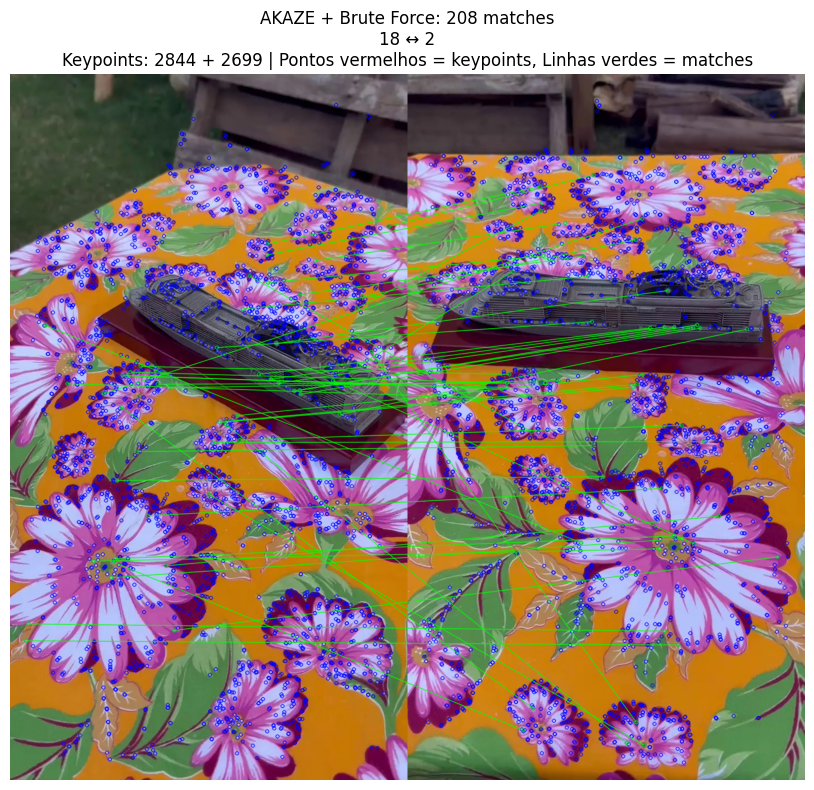

 Salvo: ../../data/T2/interim/msc_grandiosa_miniatura/ComparingMatchers/AKAZE-BFMatcher-pair.jpg
 Resultados:
   • Matches encontrados: 208
   • Keypoints Img1: 2844
   • Keypoints Img2: 2699
   • Eficiência: 3.8%

=== AKAZE + FLANN Matcher ===


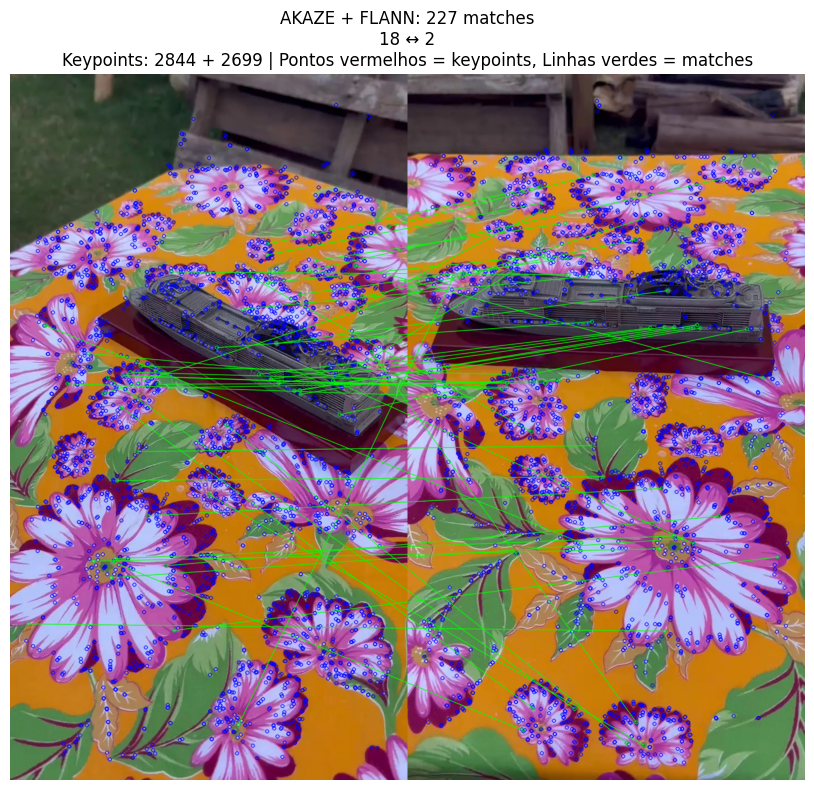

 Salvo: ../../data/T2/interim/msc_grandiosa_miniatura/ComparingMatchers/AKAZE-FlannBasedMatcher-pair.jpg
 Resultados:
   • Matches encontrados: 227
   • Keypoints Img1: 2844
   • Keypoints Img2: 2699
   • Eficiência: 4.1%



In [ ]:
# 5. AKAZE + BF Matcher
print("=== AKAZE + Brute Force Matcher ===")

if matching_results['AKAZE']['BF'] and matching_results['AKAZE']['BF']['success']:
    akaze_bf_result = matching_results['AKAZE']['BF']
    
    # Mostrar imagem com informações detalhadas
    plt.figure(figsize=(16, 8))
    img_rgb = cv2.cvtColor(akaze_bf_result['img_matches'], cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)
    
    # Título com informações completas
    title = (f'AKAZE + Brute Force: {akaze_bf_result["num_matches"]} matches\n'
             f'{img1_name} ↔ {img2_name}\n'
             f'Keypoints: {akaze_bf_result["num_keypoints_img1"]} + {akaze_bf_result["num_keypoints_img2"]} '
             f'| Pontos vermelhos = keypoints, Linhas verdes = matches')
    
    plt.title(title, fontsize=12)
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    # Salvar imagem
    save_path = f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-matcher-comparison/AKAZE-BFMatcher-pair.jpg"
    cv2.imwrite(save_path, akaze_bf_result['img_matches'])
    print(f" Salvo: {save_path}")
    print(f" Resultados:")
    print(f"   • Matches encontrados: {akaze_bf_result['num_matches']}")
    print(f"   • Keypoints Img1: {akaze_bf_result['num_keypoints_img1']}")
    print(f"   • Keypoints Img2: {akaze_bf_result['num_keypoints_img2']}")
    print(f"   • Eficiência: {akaze_bf_result['num_matches']/(akaze_bf_result['num_keypoints_img1']+akaze_bf_result['num_keypoints_img2'])*100:.1f}%")
else:
    print(" AKAZE + BF: Falha na análise")

print("\n" + "="*50)

# 6. AKAZE + FLANN Matcher  
print("=== AKAZE + FLANN Matcher ===")

if matching_results['AKAZE']['FLANN'] and matching_results['AKAZE']['FLANN']['success']:
    akaze_flann_result = matching_results['AKAZE']['FLANN']
    
    # Mostrar imagem com informações detalhadas
    plt.figure(figsize=(16, 8))
    img_rgb = cv2.cvtColor(akaze_flann_result['img_matches'], cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)
    
    # Título com informações completas
    title = (f'AKAZE + FLANN: {akaze_flann_result["num_matches"]} matches\n'
             f'{img1_name} ↔ {img2_name}\n'
             f'Keypoints: {akaze_flann_result["num_keypoints_img1"]} + {akaze_flann_result["num_keypoints_img2"]} '
             f'| Pontos vermelhos = keypoints, Linhas verdes = matches')
    
    plt.title(title, fontsize=12)
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    # Salvar imagem
    save_path = f"../../data/T2/interim/{SELECTED_OBJECT}/S2-hpbv-matcher-comparison/AKAZE-FlannBasedMatcher-pair.jpg"
    cv2.imwrite(save_path, akaze_flann_result['img_matches'])
    print(f" Salvo: {save_path}")
    print(f" Resultados:")
    print(f"   • Matches encontrados: {akaze_flann_result['num_matches']}")
    print(f"   • Keypoints Img1: {akaze_flann_result['num_keypoints_img1']}")
    print(f"   • Keypoints Img2: {akaze_flann_result['num_keypoints_img2']}")
    print(f"   • Eficiência: {akaze_flann_result['num_matches']/(akaze_flann_result['num_keypoints_img1']+akaze_flann_result['num_keypoints_img2'])*100:.1f}%")
else:
    print(" AKAZE + FLANN: Falha na análise")

print("\n" + "="*50)

### Comparações de Matchers

 COMPARAÇÃO COMPLETA: Brute Force Matcher com SIFT, ORB e AKAZE
 SIFT + BF: 262 matches | KP: 2000+2000
 ORB + BF: 164 matches | KP: 3000+3000
 AKAZE + BF: 208 matches | KP: 2844+2699


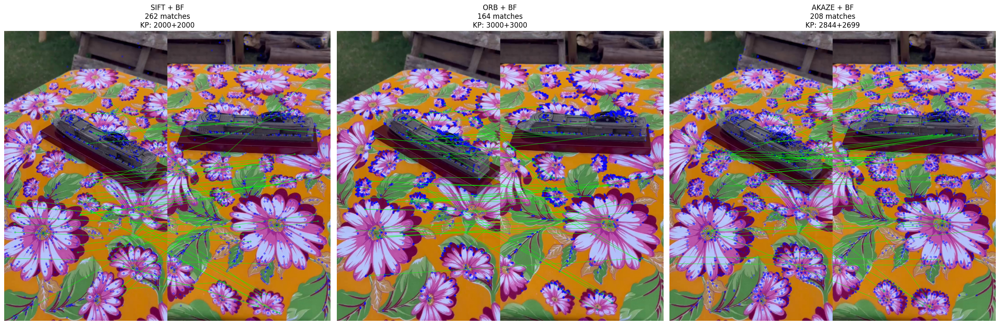


 Comparação salva: ../../data/T2/interim/msc_grandiosa_miniatura/ComparingMatchers/BFComparison.png

 Estatísticas Brute Force:
   • Detectores bem-sucedidos: 3/3
   • Média de matches: 211.3
   • Melhor: 262 matches
   • Total de keypoints por imagem: 15543


<Figure size 640x480 with 0 Axes>

In [114]:
# Comparação: Brute Force para todos os detectores
print(" COMPARAÇÃO COMPLETA: Brute Force Matcher com SIFT, ORB e AKAZE")
print("="*75)

bf_detectors = ['SIFT', 'ORB', 'AKAZE']
bf_matches = []
bf_images = []
bf_keypoints = []

for detector in bf_detectors:
    if (matching_results[detector]['BF'] and 
        matching_results[detector]['BF']['success']):
        result = matching_results[detector]['BF']
        bf_matches.append(result['num_matches'])
        bf_images.append(result['img_matches'])
        bf_keypoints.append((result['num_keypoints_img1'], result['num_keypoints_img2']))
        print(f" {detector} + BF: {result['num_matches']:3d} matches | "
              f"KP: {result['num_keypoints_img1']}+{result['num_keypoints_img2']}")
    else:
        print(f" {detector} + BF: Falha")
        bf_matches.append(0)
        bf_images.append(None)
        bf_keypoints.append((0, 0))

# Criar subplot side-by-side com informações detalhadas
fig, axes = plt.subplots(1, 3, figsize=(24, 8))

for i, (detector, img, matches, kp_counts) in enumerate(zip(bf_detectors, bf_images, bf_matches, bf_keypoints)):
    if img is not None:
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        axes[i].imshow(img_rgb)
        title = f'{detector} + BF\n{matches} matches\nKP: {kp_counts[0]}+{kp_counts[1]}'
        axes[i].set_title(title, fontsize=12)
    else:
        axes[i].text(0.5, 0.5, f'{detector} + BF\nFALHA', 
                    ha='center', va='center', transform=axes[i].transAxes,
                    fontsize=12, color='red')
    axes[i].axis('off')

plt.tight_layout()
plt.show()

# Salvar comparação
comparison_path = f"../../data/T2/interim/{SELECTED_OBJECT}/ComparingMatchers/BFComparison.png"
plt.savefig(comparison_path, dpi=150, bbox_inches='tight')
print(f"\n Comparação salva: {comparison_path}")

# Estatísticas do BF
successful_bf = [m for m in bf_matches if m > 0]
if successful_bf:
    print(f"\n Estatísticas Brute Force:")
    print(f"   • Detectores bem-sucedidos: {len(successful_bf)}/3")
    print(f"   • Média de matches: {sum(successful_bf)/len(successful_bf):.1f}")
    print(f"   • Melhor: {max(successful_bf)} matches")
    print(f"   • Total de keypoints por imagem: {sum([kp[0]+kp[1] for kp in bf_keypoints])}")

 COMPARAÇÃO COMPLETA: FLANN Matcher com SIFT, ORB e AKAZE
 SIFT + FLANN: 282 matches | KP: 2000+2000
 ORB + FLANN: 188 matches | KP: 3000+3000
 AKAZE + FLANN: 227 matches | KP: 2844+2699


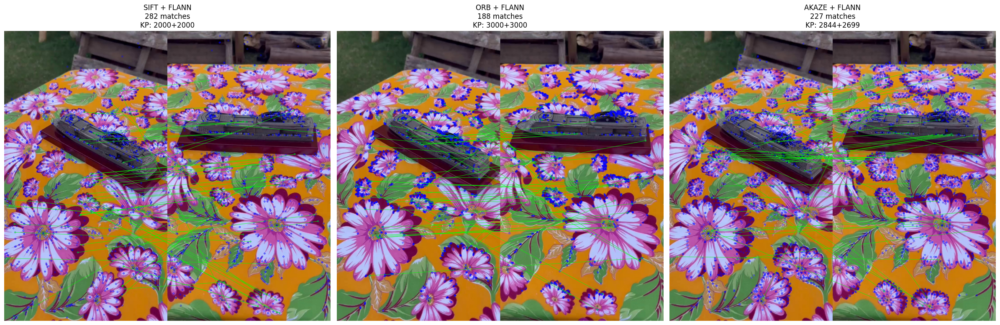


 Comparação salva: ../../data/T2/interim/msc_grandiosa_miniatura/ComparingMatchers/FlannComparison.png

 Estatísticas FLANN:
   • Detectores bem-sucedidos: 3/3
   • Média de matches: 232.3
   • Melhor: 282 matches
   • Total de keypoints por imagem: 15543

  Comparação BF vs FLANN:
Detector BF Matches   FLANN Matches  Melhor    
--------------------------------------------------
SIFT     262          282            FLANN     
ORB      164          188            FLANN     
AKAZE    208          227            FLANN     
--------------------------------------------------


<Figure size 640x480 with 0 Axes>

In [115]:
# Comparação: FLANN para todos os detectores
print(" COMPARAÇÃO COMPLETA: FLANN Matcher com SIFT, ORB e AKAZE")
print("="*75)

flann_detectors = ['SIFT', 'ORB', 'AKAZE']
flann_matches = []
flann_images = []
flann_keypoints = []

for detector in flann_detectors:
    if (matching_results[detector]['FLANN'] and 
        matching_results[detector]['FLANN']['success']):
        result = matching_results[detector]['FLANN']
        flann_matches.append(result['num_matches'])
        flann_images.append(result['img_matches'])
        flann_keypoints.append((result['num_keypoints_img1'], result['num_keypoints_img2']))
        print(f" {detector} + FLANN: {result['num_matches']:3d} matches | "
              f"KP: {result['num_keypoints_img1']}+{result['num_keypoints_img2']}")
    else:
        print(f" {detector} + FLANN: Falha")
        flann_matches.append(0)
        flann_images.append(None)
        flann_keypoints.append((0, 0))

# Cria subplot (lado a lado) com informações detalhadas
fig, axes = plt.subplots(1, 3, figsize=(24, 8))

for i, (detector, img, matches, kp_counts) in enumerate(zip(flann_detectors, flann_images, flann_matches, flann_keypoints)):
    if img is not None:
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        axes[i].imshow(img_rgb)
        title = f'{detector} + FLANN\n{matches} matches\nKP: {kp_counts[0]}+{kp_counts[1]}'
        axes[i].set_title(title, fontsize=12)
    else:
        axes[i].text(0.5, 0.5, f'{detector} + FLANN\nFALHA', 
                    ha='center', va='center', transform=axes[i].transAxes,
                    fontsize=12, color='red')
    axes[i].axis('off')

plt.tight_layout()
plt.show()

# Salva comparação
comparison_path = f"../../data/T2/interim/{SELECTED_OBJECT}/ComparingMatchers/FlannComparison.png"
plt.savefig(comparison_path, dpi=150, bbox_inches='tight')
print(f"\n Comparação salva: {comparison_path}")

# Estatísticas do FLANN
successful_flann = [m for m in flann_matches if m > 0]
if successful_flann:
    print(f"\n Estatísticas FLANN:")
    print(f"   • Detectores bem-sucedidos: {len(successful_flann)}/3")
    print(f"   • Média de matches: {sum(successful_flann)/len(successful_flann):.1f}")
    print(f"   • Melhor: {max(successful_flann)} matches")
    print(f"   • Total de keypoints por imagem: {sum([kp[0]+kp[1] for kp in flann_keypoints])}")

# Comparação direta BF vs FLANN
print(f"\n  Comparação BF vs FLANN:")
print(f"{'Detector':<8} {'BF Matches':<12} {'FLANN Matches':<14} {'Melhor':<10}")
print("-" * 50)

for i, detector in enumerate(['SIFT', 'ORB', 'AKAZE']):
    bf_count = bf_matches[i]
    flann_count = flann_matches[i]
    
    if bf_count > 0 or flann_count > 0:
        melhor = "BF" if bf_count > flann_count else "FLANN" if flann_count > bf_count else "Empate"
        print(f"{detector:<8} {bf_count:<12} {flann_count:<14} {melhor:<10}")
    else:
        print(f"{detector:<8} {'Falha':<12} {'Falha':<14} {'N/A':<10}")

print("-" * 50)

In [116]:
# Análise Estatística Final Completa
print(" ANÁLISE ESTATÍSTICA COMPLETA COM KEYPOINTS")
print("="*60)

# Coletar todos os resultados para análise
results_summary = {}
keypoints_summary = {}
all_combinations = [
    ('SIFT', 'BF'), ('SIFT', 'FLANN'),
    ('ORB', 'BF'), ('ORB', 'FLANN'),
    ('AKAZE', 'BF'), ('AKAZE', 'FLANN')
]

print(" Resumo COMPLETO por Combinação:")
print("-" * 60)
print(f"{'Combinação':<15} {'Matches':<8} {'KP Img1':<8} {'KP Img2':<8} {'Status'}")
print("-" * 60)

for detector, matcher in all_combinations:
    result = matching_results[detector][matcher]
    if result and result['success']:
        num_matches = result['num_matches']
        kp1 = result['num_keypoints_img1']
        kp2 = result['num_keypoints_img2']
        status = "OK"
        
        results_summary[f"{detector}+{matcher}"] = num_matches
        keypoints_summary[f"{detector}+{matcher}"] = (kp1, kp2)
    else:
        num_matches = 0
        kp1 = result['num_keypoints_img1'] if result else 0
        kp2 = result['num_keypoints_img2'] if result else 0
        status = "FAIL"
        
        results_summary[f"{detector}+{matcher}"] = 0
        keypoints_summary[f"{detector}+{matcher}"] = (kp1, kp2)
    
    combo_name = f"{detector}+{matcher}"
    print(f"{combo_name:<15} {num_matches:<8} {kp1:<8} {kp2:<8} {status}")

print("-" * 60)

# Estatísticas gerais
successful_combinations = [v for v in results_summary.values() if v > 0]
if successful_combinations:
    print(f"\n Estatísticas de Matches:")
    print(f"   • Combinações bem-sucedidas: {len(successful_combinations)}/6")
    print(f"   • Média de matches: {sum(successful_combinations)/len(successful_combinations):.1f}")
    print(f"   • Máximo de matches: {max(successful_combinations)}")
    print(f"   • Mínimo de matches: {min(successful_combinations)}")
    
    # Melhor combinação
    best_combo = max(results_summary.items(), key=lambda x: x[1])
    print(f"   • Melhor combinação: {best_combo[0]} ({best_combo[1]} matches)")
    
    # Estatísticas de keypoints
    all_kp1 = [kp[0] for kp in keypoints_summary.values()]
    all_kp2 = [kp[1] for kp in keypoints_summary.values()]
    
    print(f"\n Estatísticas de Keypoints:")
    print(f"   • Média KP Imagem 1: {sum(all_kp1)/len(all_kp1):.1f}")
    print(f"   • Média KP Imagem 2: {sum(all_kp2)/len(all_kp2):.1f}")
    print(f"   • Total keypoints detectados: {sum(all_kp1) + sum(all_kp2)}")
    
    # Eficiência de matching (matches/keypoints)
    print(f"\n Eficiência de Matching:")
    for combo, matches in results_summary.items():
        if matches > 0:
            kp1, kp2 = keypoints_summary[combo]
            total_kp = kp1 + kp2
            efficiency = (matches / total_kp * 100) if total_kp > 0 else 0
            print(f"   • {combo}: {efficiency:.1f}% ({matches}/{total_kp})")
    
else:
    print("\n Nenhuma combinação foi bem-sucedida")

print(f"\n Arquivos Salvos:")
print(f"    Diretório: ../../data/T2/interim/{SELECTED_OBJECT}/")
print(f"     Individuais: DETECTOR-MATCHER-pair.jpg (6 arquivos)")
print(f"    Comparativas: BFComparison.png, FlannComparison.png")

print(f"   • Imagens analisadas: {img1_name} ↔ {img2_name}")
print(f"   • Detectores testados: SIFT, ORB, AKAZE")
print(f"   • Matchers testados: Brute Force, FLANN")
print(f"   • Visualizações: keypoints + correspondências")

 ANÁLISE ESTATÍSTICA COMPLETA COM KEYPOINTS
 Resumo COMPLETO por Combinação:
------------------------------------------------------------
Combinação      Matches  KP Img1  KP Img2  Status
------------------------------------------------------------
SIFT+BF         262      2000     2000     OK
SIFT+FLANN      282      2000     2000     OK
ORB+BF          164      3000     3000     OK
ORB+FLANN       188      3000     3000     OK
AKAZE+BF        208      2844     2699     OK
AKAZE+FLANN     227      2844     2699     OK
------------------------------------------------------------

 Estatísticas de Matches:
   • Combinações bem-sucedidas: 6/6
   • Média de matches: 221.8
   • Máximo de matches: 282
   • Mínimo de matches: 164
   • Melhor combinação: SIFT+FLANN (282 matches)

 Estatísticas de Keypoints:
   • Média KP Imagem 1: 2614.7
   • Média KP Imagem 2: 2566.3
   • Total keypoints detectados: 31086

 Eficiência de Matching:
   • SIFT+BF: 6.6% (262/4000)
   • SIFT+FLANN: 7.0% (282/4000